*Creado desde el repositorio Aves de Eduardo Graells-Garrido (Barcelona Supercomputing Center, <eduardo.graells@bsc.es>)*  
*Modificado por Tabita Catalán (DIM, FCFM, U. Chile, <tcatalan@dim.uchile.cl>)*

# Práctica 5: Redes en un Mapa



En este notebook exploraremos los viajes de la Encuesta Origen-Destino 2012 de Santiago utilizando visualizaciones de redes.

### Preámbulo

In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import geopandas as gpd

from aves.data import DATA_PATH
from aves.data import eod, census
from aves.features.utils import normalize_rows

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# esto configura la apariencia de los gráficos: tamaños de letra, bordes, colores base, etc.
sns.set(context='paper', font='Fira Code', style='ticks', palette='colorblind', font_scale=1.1)

In [3]:
comunas = census.read_census_map('comuna')

In [4]:
zones = gpd.read_file(DATA_PATH / 'processed/scl_zonas_urbanas.json').set_index('ID')
zones.head()

,AREA,Zona,Com,Comuna,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,NOM_COMUNA,URBANO,TIPO,NOM_CATEG,SHAPE_Leng,SHAPE_Area,geometry
ID,,,,,,,,,,,,,,,
103,837.7500,103.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.65485 -33.55436, -70.65497 -33.5..."
104,998.8125,104.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.67891 -33.55911, -70.67767 -33.5..."
106,286.2500,106.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.67599 -33.55542, -70.67767 -33.5..."
115,857.4375,115.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.67599 -33.55542, -70.67602 -33.5..."
116,853.9375,116.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.66819 -33.55207, -70.66701 -33.5..."


In [5]:
zones['node_id'] = range(len(zones))
zones.head()

,AREA,Zona,Com,Comuna,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,NOM_COMUNA,URBANO,TIPO,NOM_CATEG,SHAPE_Leng,SHAPE_Area,geometry,node_id
ID,,,,,,,,,,,,,,,,
103,837.7500,103.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.65485 -33.55436, -70.65497 -33.5...",0
104,998.8125,104.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.67891 -33.55911, -70.67767 -33.5...",1
106,286.2500,106.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.67599 -33.55542, -70.67767 -33.5...",2
115,857.4375,115.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.67599 -33.55542, -70.67602 -33.5...",3
116,853.9375,116.0,13105,El Bosque,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,EL BOSQUE,EL BOSQUE,CAPITAL COMUNAL,CIUDAD,0.152123,0.001391,"POLYGON ((-70.66819 -33.55207, -70.66701 -33.5...",4


In [6]:
viajes = eod.read_trips()

# descartamos sectores que no sean relevantes en los orígenes y destinos de los viajes
viajes = viajes[(viajes['SectorOrigen'] != 'Exterior a RM') 
                & (viajes['SectorDestino'] != 'Exterior a RM')
                & (viajes['SectorOrigen'] != 'Extensión Sur-Poniente') 
                & (viajes['SectorDestino'] != 'Extensión Sur-Poniente')
                & pd.notnull(viajes['SectorOrigen'])
                & pd.notnull(viajes['SectorDestino'])
                # también descartamos viajes que hayan sido imputados en la encuesta
                & (viajes['Imputada'] == 0)
                # y finalmente descartamos viajes cuya distancia indique que son viajes cortísimos o bien demasiado largos para el tamaño de la ciudad
                & (viajes['DistManhattan'].between(500, 35000))]

print(len(viajes))

77288


In [7]:
personas = eod.read_people()
viajes_persona = viajes.merge(personas)

In [8]:
viajes_persona['PesoLaboral'] = viajes_persona['FactorLaboralNormal'] * viajes_persona['Factor_LaboralNormal']

## ¿Cómo se relacionan las comunas de acuerdo a los viajes entre ellas, por propósito?

Primero, preparemos el `GeoDataFrame` de comunas. Tenemos que quedarnos solo con las comunas que nos interesan, y tenemos que asegurarnos que tenga los mismos nombres que en el `DataFrame` de viajes.

In [9]:
comunas.head()

,REGION,NOM_REGION,PROVINCIA,NOM_PROVIN,COMUNA,NOM_COMUNA,SHAPE_Leng,SHAPE_Area,geometry
0,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13404,PAINE,1.625330,0.066035,"POLYGON ((-70.61889 -33.73808, -70.61811 -33.7..."
1,13,REGIÓN METROPOLITANA DE SANTIAGO,134,MAIPO,13402,BUIN,0.884164,0.021166,"POLYGON ((-70.63192 -33.64634, -70.63207 -33.6..."
2,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13124,PUDAHUEL,0.720176,0.019124,"POLYGON ((-70.78914 -33.36153, -70.78824 -33.3..."
3,13,REGIÓN METROPOLITANA DE SANTIAGO,131,SANTIAGO,13103,CERRO NAVIA,0.170180,0.001076,"POLYGON ((-70.71927 -33.41334, -70.71888 -33.4..."
4,13,REGIÓN METROPOLITANA DE SANTIAGO,133,CHACABUCO,13301,COLINA,1.692007,0.093820,"POLYGON ((-70.59630 -32.95138, -70.59673 -32.9..."


Hacemos dos cosas:

- Como tenemos las zonas urbanas, filtramos el `GeoDataFrame` para quedarnos solamente con aquellas comunas que están en el `DataFrame` de zonas.
- Hacemos un diccionario de `código de comuna -> nombre de comuna` a partir de las zonas y lo aplicamos.

findfont: Font family ['Fira Code'] not found. Falling back to DejaVu Sans.


<AxesSubplot:>

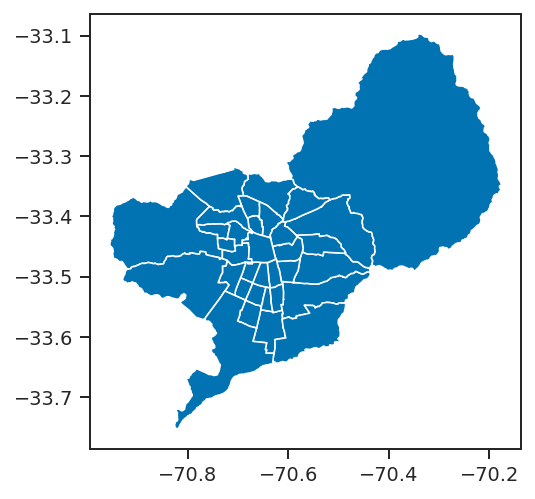

In [10]:
comunas_urbanas = comunas[comunas['COMUNA'].isin(zones['Com'].unique())].drop('NOM_COMUNA', axis=1).copy()
comunas_urbanas['NombreComuna'] = comunas_urbanas['COMUNA'].map(dict(zip(zones['Com'], zones['Comuna'])))
comunas_urbanas.plot()

El mapa es demasiado grande, así que lo recortaremos utilizando las zonas que conocemos:

In [11]:
from aves.features.geo import clip_area_geodataframe

In [12]:
bounding_box = zones.total_bounds
bounding_box

array([-70.88006218, -33.72603779, -70.43015094, -33.31109652])

In [13]:
comunas_urbanas = clip_area_geodataframe(comunas_urbanas, zones.total_bounds, buffer=0.05)

Necesitamos que los nodos tengan un identificador numérico, cuyo valor inicial es cero.

In [14]:
comunas_urbanas['node_id'] = range(len(comunas_urbanas))

In [15]:
comunas_urbanas['node_id']

2      0
3      1
7      2
8      3
11     4
12     5
13     6
14     7
15     8
16     9
18    10
19    11
20    12
21    13
22    14
23    15
24    16
25    17
26    18
27    19
28    20
29    21
31    22
32    23
35    24
36    25
37    26
39    27
42    28
43    29
44    30
45    31
46    32
47    33
Name: node_id, dtype: int64

Calculamos la lista de aristas de nuestra red, es decir, la cantidad de viajes de una comuna a otra. En este caso, lo haremos con los viajes al trabajo.

In [16]:
viajes_persona.groupby(['Proposito']).agg(n_viajes=('PesoLaboral', 'sum'))

,n_viajes
Proposito,
Al estudio,1.110220e+06
Al trabajo,2.334846e+06
Buscar o Dejar a alguien,5.236541e+05
Buscar o dejar algo,4.619004e+04
Comer o Tomar algo,7.487267e+04
De compras,6.370015e+05
De salud,2.949270e+05
Otra actividad (especifique),1.687481e+05
Por estudio,1.027004e+05


In [17]:
def get_matrix(viajes_persona, proposito, groupby):
    """Obtener matriz de numero de viajes con cierto proposito, agrupados
    # Inputs
    viajes_persona: pandas df
    proposito: str. 
    groupby: list(str)
        Nombres de las columnas sobre las que se agrupará    
    # Mas detalles 
    Los propositos son: 'Al estudio', 'Al trabajo', 'Buscar o Dejar a alguien',
        'Buscar o dejar algo', 'Comer o Tomar algo', 'De compras', 'De salud', 
        'Otra actividad (especifique)', 'Por estudio', 'Por trabajo', 'Recreación',
        'Trámites', 'Visitar a alguien', 'volver a casa'.
    """

    matriz = (viajes_persona[(viajes_persona['Proposito'] == proposito) 
                                  & (viajes_persona['ComunaOrigen'].isin(comunas_urbanas['NombreComuna']))
                                  & (viajes_persona['ComunaDestino'].isin(comunas_urbanas['NombreComuna']))]
                    .groupby(groupby)
                    .agg(n_viajes=('PesoLaboral', 'sum'))
                    .reset_index()
    )
    return matriz
matriz = get_matrix(viajes_persona, 'Al trabajo', ['ComunaOrigen', 'ComunaDestino'])
matriz.head()

,ComunaOrigen,ComunaDestino,n_viajes
0,Cerrillos,Cerrillos,3661.151331
1,Cerrillos,Conchalí,142.637327
2,Cerrillos,El Bosque,68.819420
3,Cerrillos,Estación Central,635.342831
4,Cerrillos,Independencia,569.960711


Podemos convertir esta lista en una matriz de adyacencia. Veamos como luce esta matriz con el esquema `adjacency_matrix`. Como vimos en clase, utiliza la misma codificación visual que el `heatmap` de tablas, por lo que podemos usar `seaborn.heatmap` para visualizarla:

<AxesSubplot:xlabel='ComunaDestino', ylabel='ComunaOrigen'>

findfont: Font family ['Fira Code'] not found. Falling back to DejaVu Sans.


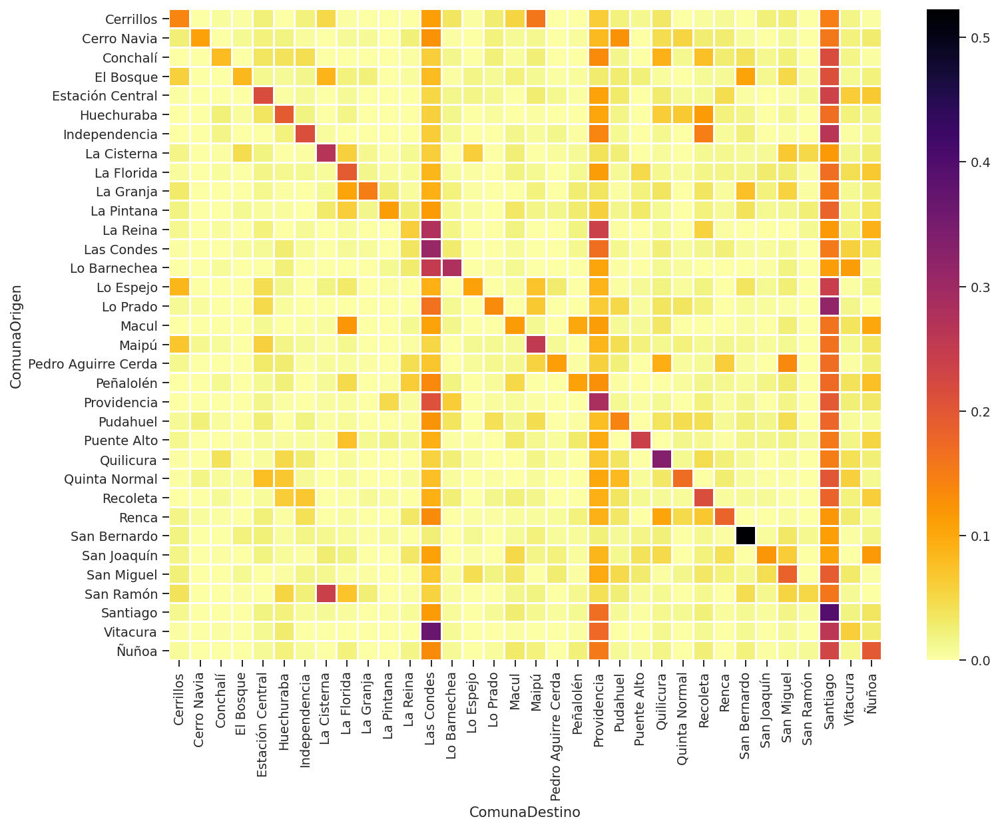

In [18]:
fig, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(matriz.set_index(['ComunaOrigen', 'ComunaDestino'])['n_viajes'].unstack(fill_value=0).pipe(normalize_rows), cmap='inferno_r', linewidth=1)

Necesitaremos un mapa de `comuna -> nodo` para aplicarlo a la tabla, para que `graph-tool` pueda construir las aristas.

In [19]:
comuna_to_node = dict(zip(comunas_urbanas['NombreComuna'], comunas_urbanas['node_id']))
comuna_to_node

{'Pudahuel': 0,
 'Cerro Navia': 1,
 'Huechuraba': 2,
 'Conchalí': 3,
 'La Pintana': 4,
 'El Bosque': 5,
 'Estación Central': 6,
 'Pedro Aguirre Cerda': 7,
 'Recoleta': 8,
 'Independencia': 9,
 'Lo Espejo': 10,
 'La Cisterna': 11,
 'La Florida': 12,
 'Peñalolén': 13,
 'Las Condes': 14,
 'La Reina': 15,
 'Lo Barnechea': 16,
 'Vitacura': 17,
 'Quinta Normal': 18,
 'Lo Prado': 19,
 'Cerrillos': 20,
 'Maipú': 21,
 'Macul': 22,
 'Ñuñoa': 23,
 'Puente Alto': 24,
 'Quilicura': 25,
 'Renca': 26,
 'San Bernardo': 27,
 'San Joaquín': 28,
 'San Miguel': 29,
 'San Ramón': 30,
 'La Granja': 31,
 'Providencia': 32,
 'Santiago': 33}

Asignamos los identificadores de nodo para cada arista:

In [20]:
matriz['source'] = matriz['ComunaOrigen'].map(comuna_to_node)

In [21]:
matriz['target'] = matriz['ComunaDestino'].map(comuna_to_node)

Así luce:

In [24]:
matriz.head()

,ComunaOrigen,ComunaDestino,n_viajes,source,target
0,Cerrillos,Cerrillos,3661.151331,20,20
1,Cerrillos,Conchalí,142.637327,20,3
2,Cerrillos,El Bosque,68.819420,20,5
3,Cerrillos,Estación Central,635.342831,20,6
4,Cerrillos,Independencia,569.960711,20,9


Ahora podemos construir nuestra red. Adicionalmente, quitaremos las aristas con menos peso, para disminuir el _clutter_ de la imagen. La función `graph_from_pandas_edgelist` de `aves` nos facilita la construcción de la red:

In [25]:
from aves.features.network import graph_from_pandas_edgelist

In [58]:
matriz[matriz['n_viajes'] > matriz['n_viajes'].quantile(0.2)]

,ComunaOrigen,ComunaDestino,n_viajes,source,target
0,Cerrillos,Cerrillos,3661.151331,20,20
3,Cerrillos,Estación Central,635.342831,20,6
4,Cerrillos,Independencia,569.960711,20,9
5,Cerrillos,La Cisterna,1311.105800,20,11
8,Cerrillos,Las Condes,2915.622482,20,14
...,...,...,...,...,...
959,Ñuñoa,San Miguel,586.746182,23,29
960,Ñuñoa,San Ramón,908.799520,23,30
961,Ñuñoa,Santiago,21003.071894,23,33
962,Ñuñoa,Vitacura,1199.871414,23,17


In [63]:
network, edge_weight = graph_from_pandas_edgelist(matriz[matriz['n_viajes'] > matriz['n_viajes'].quantile(0.2)], 
                                                  weight='n_viajes')

Visualizaremos el resultado con una visualización `node_link` sobre un mapa:

In [64]:
from aves.visualization.figures import figure_from_geodataframe

In [65]:
from aves.visualization.maps import GeographicalNodeLink

In [66]:
geonodelink = GeographicalNodeLink(network, comunas_urbanas, node_column='node_id', edge_weight=edge_weight)

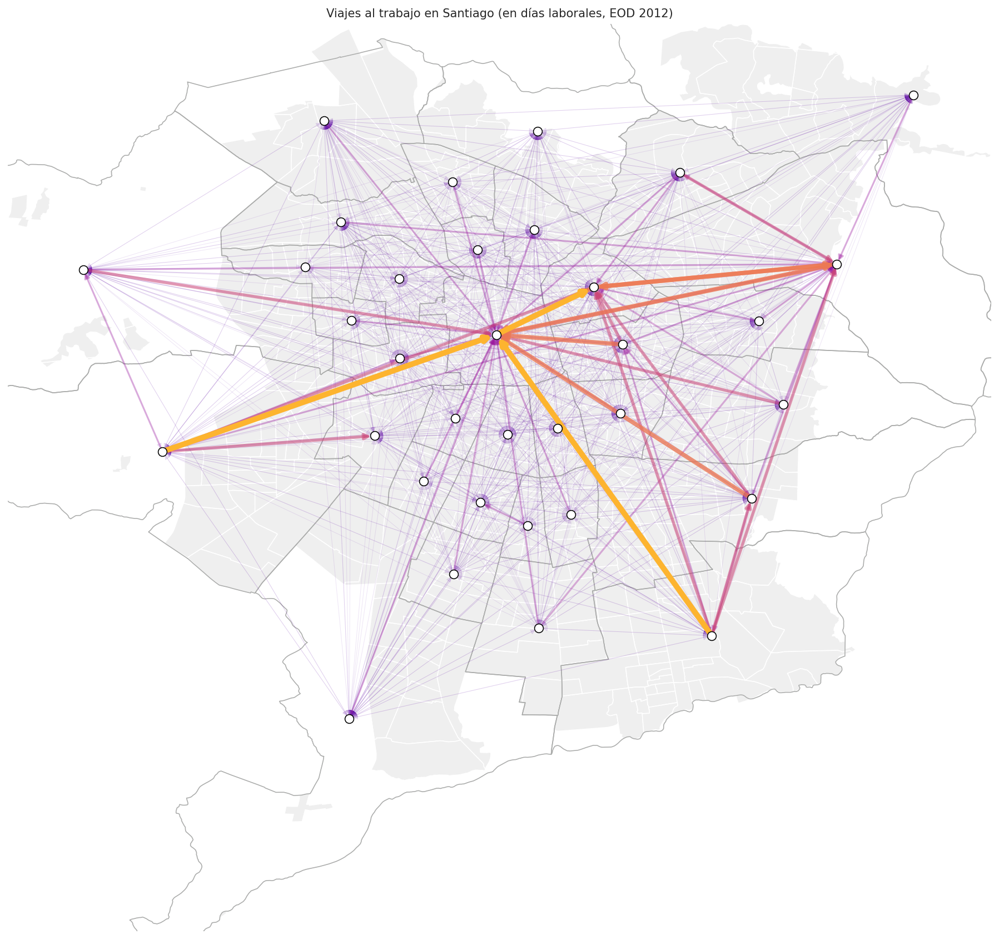

In [67]:
fig, ax = figure_from_geodataframe(zones, height=15, set_limits=True, remove_axes=True)

zones.plot(ax=ax, facecolor='#efefef', edgecolor='white', zorder=0)

comunas_urbanas.plot(ax=ax, facecolor='none', edgecolor='#abacab', zorder=0)

geonodelink.plot_nodes(ax, color='white', edgecolor='black', size=250)

geonodelink.plot_weighted_edges(ax, palette='plasma', log_transform=False, weight_bins=5,
                                min_linewidth=0.5, linewidth=5, min_alpha=0.1, alpha=1.0, 
                                with_arrows=True, arrow_shrink=3, arrow_scale=10)

ax.set_title('Viajes al trabajo en Santiago (en días laborales, EOD 2012)');

Otra forma de disminuir el clutter de la imagen es usar _Force Directed Edge Bundling (FDEB)_. Importamos la librería:

In [68]:
import forcebundle.ForcedirectedEdgeBundling as feb

Y definimos una función para para obtener las aristas a partir de la información de viajes entre comunas.

In [69]:
def red_de_comunas(comunasgdf, adyacenciadf):
    """Crea una lista de numba con aristas conectando los centroides de las comunas.
    Las conecciones están dadas por una matriz de adyacencia.
    Input: 
    - comunasgdf: GeoDataFrame de las comunas.
    - adyacenciadf: DataFrame listando numero de viajes de acuerdo a comuna de origen 
        y destino.
    Output: 
    - edges: Lista de Numba de Edges. Los puntos source y target deberían coincidir 
        con los centroides de las comunas de origen y destino respectivamente.
    - bounds: (minx, maxx, miny, maxy) coordenadas de una caja que encierra a todos 
        los nodos.
    - valid_edges: Lista de Numba con los índices de las aristas válidas. Las aristas
        demasiado cortas se descartan (los viajes con origen y destino dentro de la 
        misma comuna).    
    """
    origen = comunasgdf.iloc[adyacenciadf.source].geometry.centroid.values
    destino = comunasgdf.iloc[adyacenciadf.target].geometry.centroid.values
    pesos = adyacenciadf.n_viajes.values # esto no lo puede usar aun FDEB
    arrayedges = np.transpose(np.array([origen.x, origen.y, destino.x, destino.y]))
    edges, valid_edges = feb.array2edges(arrayedges)
    
    # bounds
    minx = min(min(arrayedges[:,0]), min(arrayedges[:,2]))
    miny = min(min(arrayedges[:,1]), min(arrayedges[:,3]))
    maxx = max(max(arrayedges[:,0]), max(arrayedges[:,2]))
    maxy = max(max(arrayedges[:,1]), max(arrayedges[:,3]))
    bounds = (minx, maxx, miny, maxy)
    return edges, bounds, valid_edges

In [45]:
edges, bounds, valid_edges = red_de_comunas(comunas_urbanas, matriz)

Luego procesamos las aristas usando _(FDEB)_

In [46]:
output_lines = feb.forcebundle(edges)

930


  0%|          | 0/929 [00:00<?, ?Edges/s]

  0%|          | 0/6 [00:00<?, ?cycle/s]

Podemos obtener un gráfico simple de las aristas usando `usageHelper`. Primero transformamos las aristas a líneas, las que graficamos con `plot_lines`.

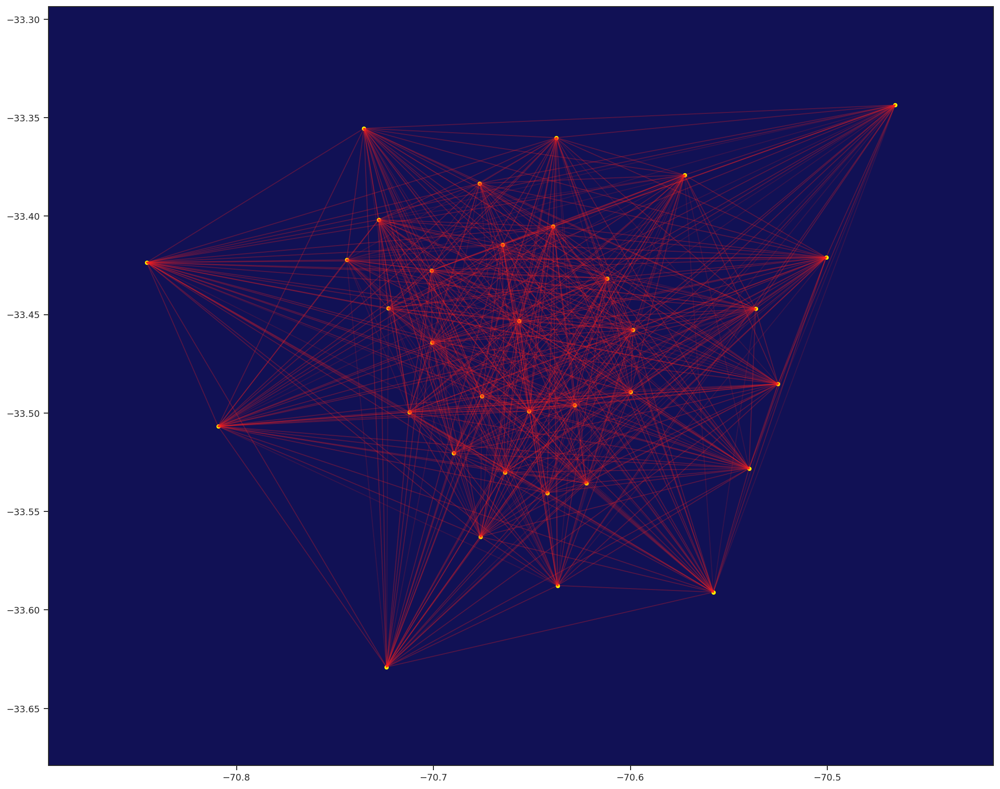

In [54]:
import forcebundle.usageHelper as uh
input_lines = feb.edges2lines(edges)

uh.plot_lines(input_lines, margin = 0.05)

_FDEB_ entrega las aristas listas para ser graficadas con `plot_lines`.

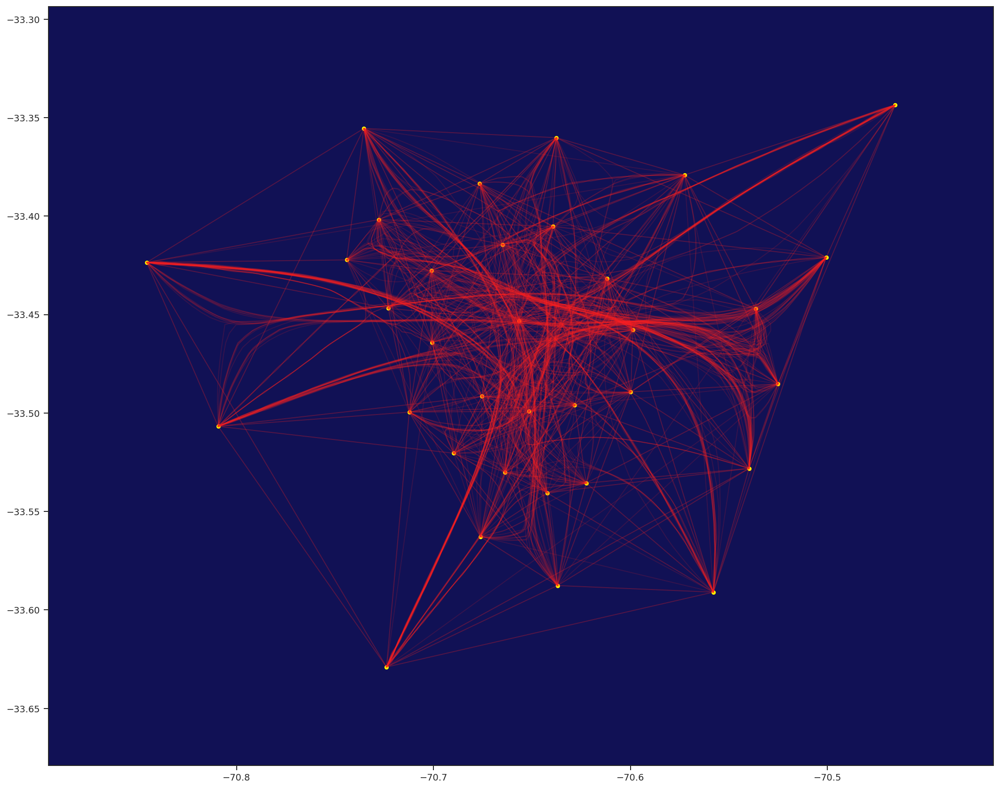

In [55]:
uh.plot_lines(output_lines, margin = 0.05)

Podemos colorear las aristas usando `multicolored_lines`. Esto nos permitirá ver la orientación de las aristas; los viajes comienzan en color rosado y terminan en amarillo.

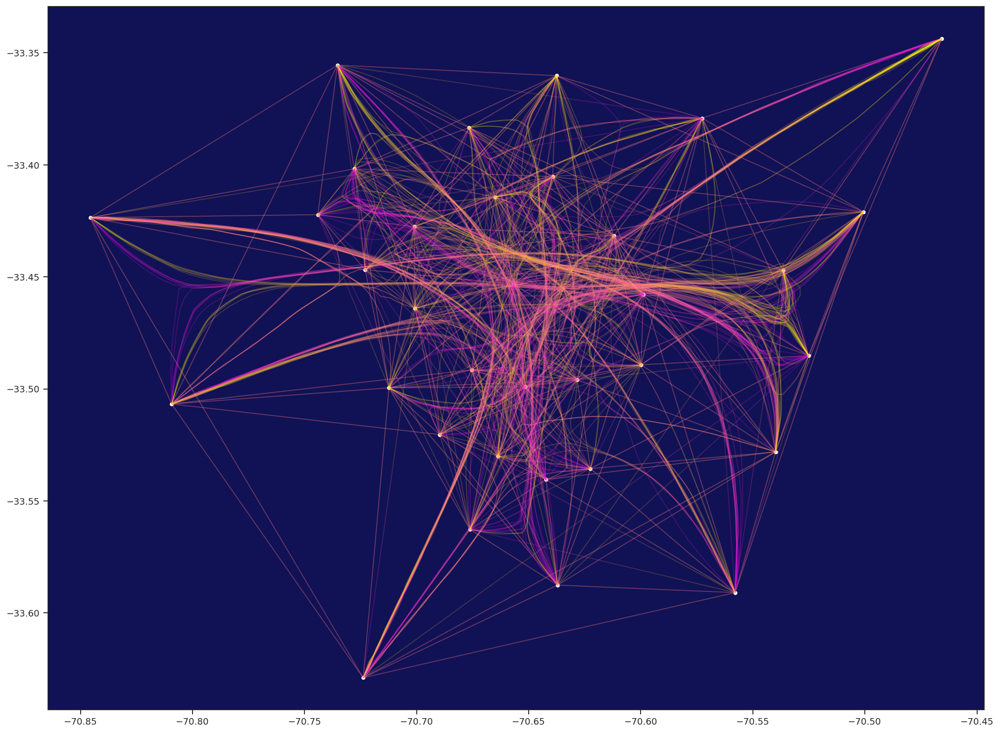

In [53]:
import forcebundle.multicolored_lines as mcl

mcl.gradient_plotlines(output_lines, bounds, comunas_urbanas.geometry.centroid, margin = 0.1,
                       cmap = plt.get_cmap('spring'), 
                      linewidth = 1, 
                      alpha = .2)

Finalmente, también podemos hacer un gráfico incorporando un mapa con las zonas y comunas.

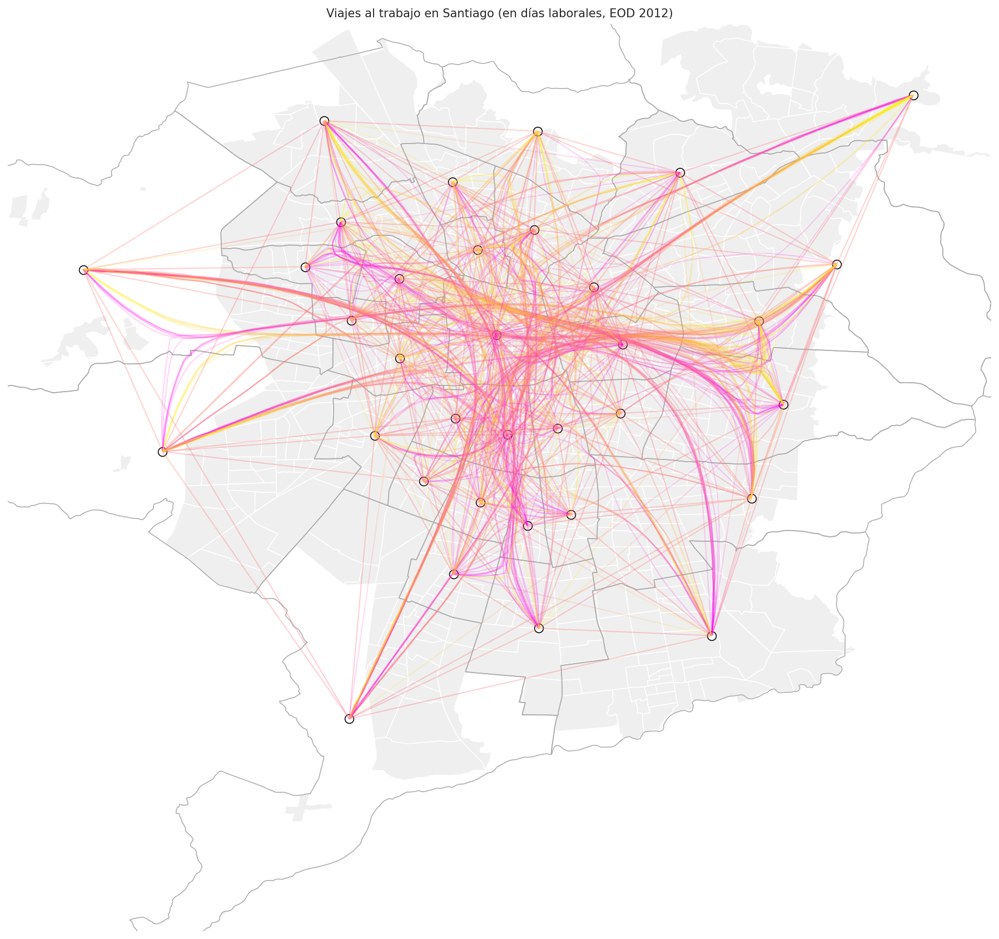

In [85]:
fig, ax = figure_from_geodataframe(zones, height=15, set_limits=True, remove_axes=True)

zones.plot(ax=ax, facecolor='#efefef', edgecolor='white', zorder=0)

comunas_urbanas.plot(ax=ax, facecolor='none', edgecolor='#abacab', zorder=0)

ax.set_title('Viajes al trabajo en Santiago (en días laborales, EOD 2012)');

mcl.draw_bundled_gradient_edges(output_lines, alpha = 0.2, linewidth = 1, cmap = 'spring')
geonodelink.plot_nodes(ax, color='white', edgecolor='black', size=250)


## Viajes por zonas

_FDEB_ no permite asociar pesos a las aristas aún, por lo que los gráficos a nivel comunal no presentan los patrones esperados. Haremos gráficos usando las zonas censales. Por comodidad haremos una función que encapsule el proceso de obtener las aristas y doblarlas, entregando las líneas listas para graficar.

In [73]:
viajes_persona.head()

,Hogar,Persona,Viaje,Etapas,ComunaOrigen,ComunaDestino,SectorOrigen,SectorDestino,ZonaOrigen,ZonaDestino,...,IngresoFinal,TramoIngresoFinal,IngresoImputado,Factor_LaboralNormal,Factor_SabadoNormal,Factor_DomingoNormal,Factor_LaboralEstival,Factor_FindesemanaEstival,FactorPersona,PesoLaboral
0,173431,17343102,1734310202,1,Maipú,Maipú,Poniente,Poniente,400,407,...,0,0,0,142.3375,NaN,NaN,NaN,NaN,53.39174,142.337500
1,173431,17343102,1734310201,1,Maipú,Maipú,Poniente,Poniente,407,400,...,0,0,0,142.3375,NaN,NaN,NaN,NaN,53.39174,142.337500
2,173441,17344101,1734410101,2,Maipú,Las Condes,Poniente,Oriente,407,307,...,350000,2,0,112.9581,NaN,NaN,NaN,NaN,46.32137,127.328613
3,173441,17344101,1734410102,2,Las Condes,Maipú,Oriente,Poniente,307,407,...,350000,2,0,112.9581,NaN,NaN,NaN,NaN,46.32137,127.328613
4,173441,17344103,1734410301,2,Maipú,Ñuñoa,Poniente,Oriente,407,437,...,283883,2,1,103.5267,NaN,NaN,NaN,NaN,43.02566,116.697351


In [87]:
import forcebundle.usageHelper as uh
import forcebundle.multicolored_lines as mcl

def lineas_por_zona(viajes_persona, proposito, quantile):
    """A partir de una matriz de viajes por persona, se obtienen las líneas para 
    graficar tras aplicar FDEB.
    Input: 
    - viajes_persona: DataFrame producto de un join entre viajes y personas.
    - proposito: str, los mismos que get_matrix
    - quantile: float entre 0 y 1. Se ordenan las aristas por peso (número de viajes)
        y solo se grafican las del cuantil quantile.
    Output: 
    - input_lines_zone: lineas para graficar de las aristas rectas 
    - output_lines_zone: lineas para graficar de las aristas dobladas
    - bounds_zone: limites de una caja que encierra a los nodos
    """
    matriz_zonas = get_matrix(viajes_persona, proposito, ['ZonaOrigen', 'ZonaDestino'])
    zona_to_node = dict(zip(zones['Zona'], zones['node_id']))

    matriz_zonas['source'] = matriz_zonas['ZonaOrigen'].map(zona_to_node)
    matriz_zonas['target'] = matriz_zonas['ZonaDestino'].map(zona_to_node)

    matriz_zonas_freq = matriz_zonas[matriz_zonas['n_viajes'] > matriz_zonas['n_viajes'].quantile(quantile)]

    edges_zone, bounds_zone, valid_edges_zone = edges_from_matrix(zones, matriz_zonas_freq )
    
    input_lines_zone = feb.edges2lines(edges_zone)
    output_lines_zone = feb.forcebundle(edges_zone)
    
    return input_lines_zone, output_lines_zone, bounds_zone, matriz_zonas_freq

Usaremos solamente un 30% de las aristas; aquellas que representan los viajes más frecuentes.

In [88]:
inp_trabajo, outp_trabajo, bounds_trabajo, matriz_trabajo = lineas_por_zona(viajes_persona, 'Al trabajo', 0.7)

<ipython-input-31-0e2c2b49095c>:3: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  _origen = comunas.iloc[una_matriz.source].geometry.centroid.values
<ipython-input-31-0e2c2b49095c>:4: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  _destino = comunas.iloc[una_matriz.target].geometry.centroid.values


3405


  0%|          | 0/3404 [00:00<?, ?Edges/s]

  0%|          | 0/6 [00:00<?, ?cycle/s]

Hacemos un gráfico simple de las aristas que usamos

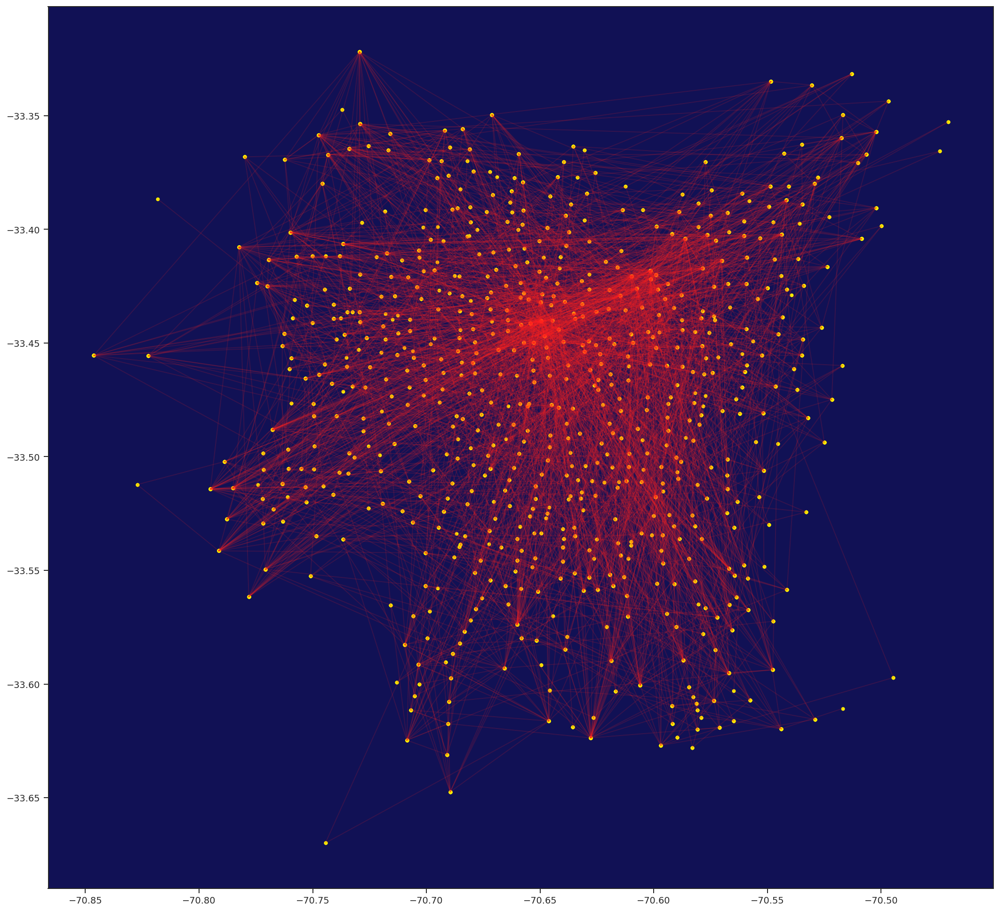

In [79]:
uh.plot_lines(inp_trabajo, margin = 0.02)

Y un gráfico después de doblar las aristas

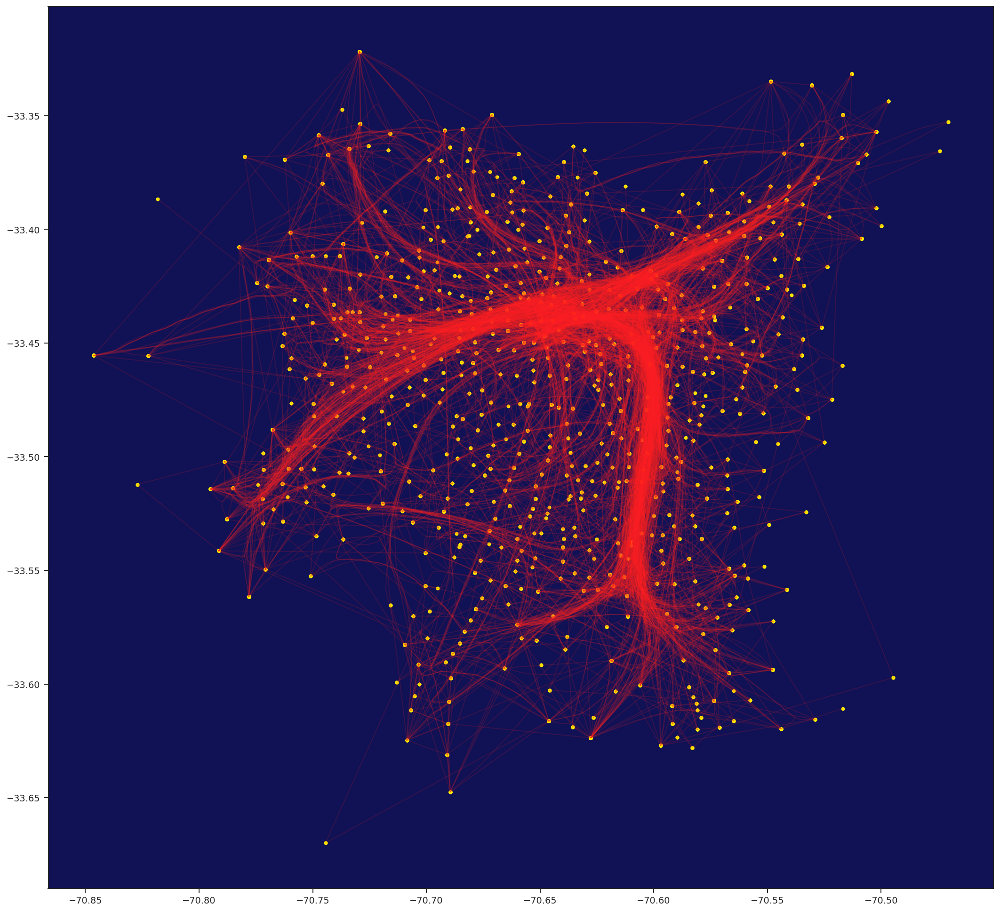

In [80]:
uh.plot_lines(outp_trabajo, margin = 0.02)

Nuevamente podemos hacer un gráfico con colores diferenciados para origen y destino

<ipython-input-81-42b9863d34d6>:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  mcl.gradient_plotlines(outp_trabajo, bounds_trabajo, zones.geometry.centroid, margin = 0.1,


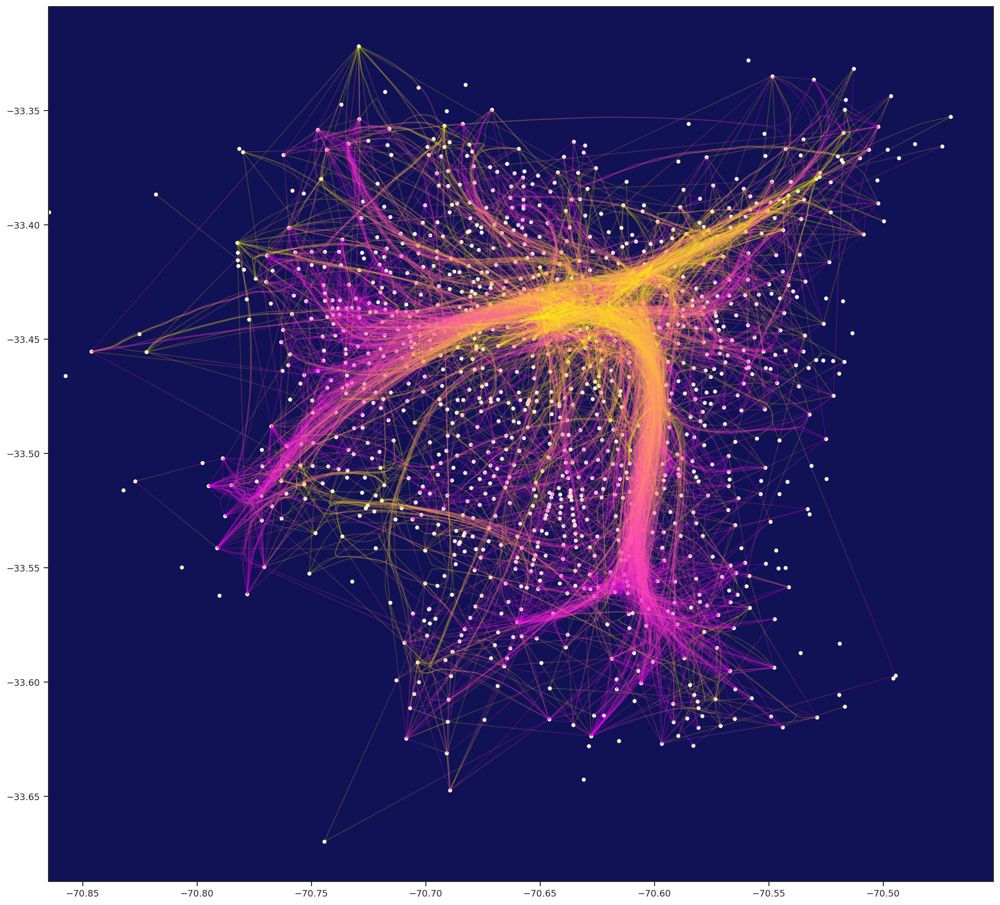

In [81]:
mcl.gradient_plotlines(outp_trabajo, bounds_trabajo, zones.geometry.centroid, margin = 0.1,
                       cmap = plt.get_cmap('spring'), 
                       linewidth = 1, 
                       alpha = .2)

Y podemos agregar también el mapa con las comunas y zonas de fondo

In [89]:
network_zone, edge_weight_zone = graph_from_pandas_edgelist(matriz_trabajo, weight='n_viajes')
geonodelink_zone = GeographicalNodeLink(network_zone, zones, node_column='node_id', edge_weight=edge_weight_zone)

/mnt/c/Users/Tabita/Documents/practica3/aves/src/aves/visualization/maps.py:196: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  self.geo_positions = geodataframe.sort_values(node_column).geometry.centroid


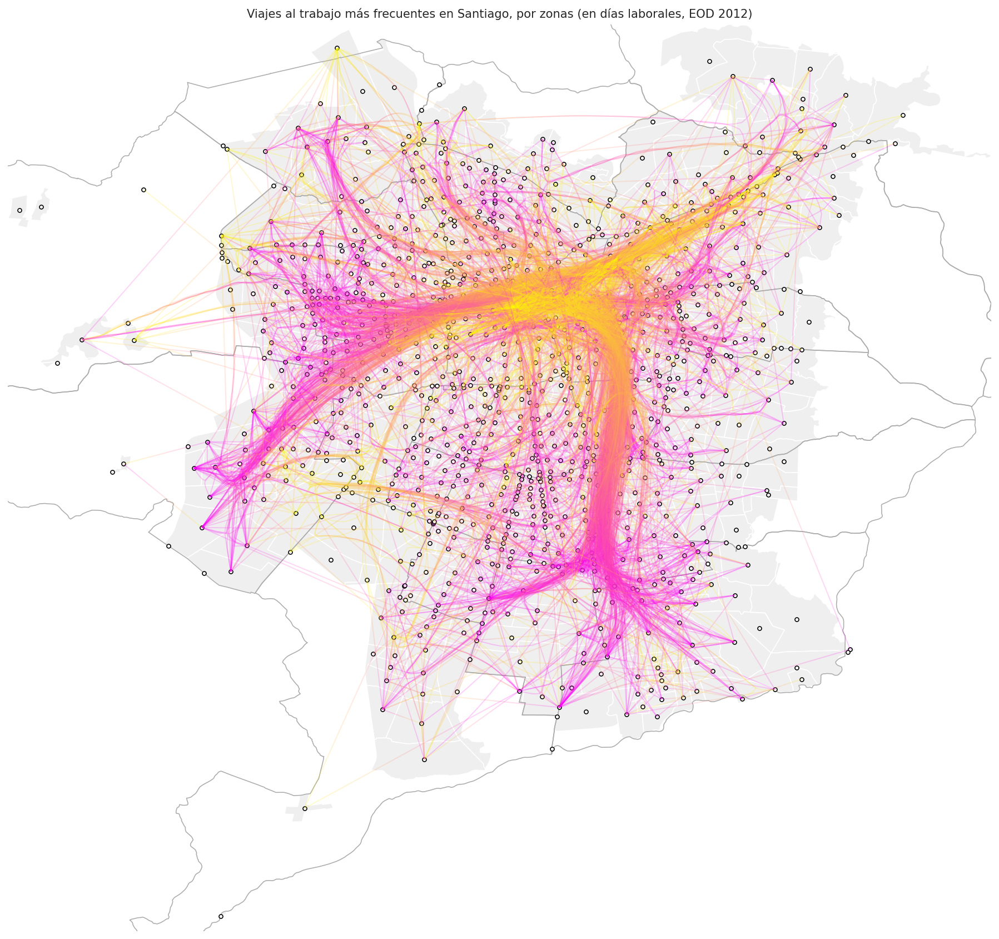

In [90]:
fig, ax = figure_from_geodataframe(zones, height=15, set_limits=True, remove_axes=True)

zones.plot(ax=ax, facecolor='#efefef', edgecolor='white', zorder=0)

comunas_urbanas.plot(ax=ax, facecolor='none', edgecolor='#abacab', zorder=0)

ax.set_title('Viajes al trabajo más frecuentes en Santiago, por zonas (en días laborales, EOD 2012)');

mcl.draw_bundled_gradient_edges(outp_trabajo, alpha = 0.2, linewidth = 1, cmap = 'spring')
geonodelink_zone.plot_nodes(ax, color='white', edgecolor='black', size=50)

¿Qué preguntas surgen al ver esta visualización? Por ej., ¿por qué la gente de Maipú va por motivos de salud a Santiago y no a Estación Central o Cerrillos?¿Por qué desde La Florida van a Providencia? Ahora bien, recuerden que este gráfico **no** muestra los viajes dentro de la misma comuna, por lo que debemos tener cuidado al responder.

### Conclusiones

En comparación con la matriz de adyacencia, en esta visualización además de identificar las relaciones entre comunas podemos apreciar el contexto geográfico. Antes de elegir una de estas dos visualizaciones, debemos considerar lo siguiente:

- ¿Nos interesa conocer la relación geográfica entre orígenes y destinos? Por ej., ¿queremos saber si comunas vecinas se comportan similar?¿Nos interesa la distancia de los viajes? En este caso, `node_link` es una buena solución.
- ¿Necesitamos ver _todas_ las aristas? Si es así, el gráfico de `node_link` podría ser inadecuado, ya que no podemos cambiar la posición de los nodos, ni podemos ver las aristas en las que el origen y destino son iguales. Debemos usar `adjacency_matrix`.